# Resynthesizing sound via spectogram

After we took a look how we can generate sounds in Python via numpy we want to take a look how we can re-synthesize a signal using numpy and some machine learning algorithms we have learned.
This allows us to yield interesting high-quality sounds without relying on neural networks that are exhausive on resources.

Instead of writing audio analysis algorithms from scratch we can use the library [librosa](https://librosa.org/doc/latest/index.html) which is a library build with the help of numpy.

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib as mpl
import librosa
import librosa.display
from IPython.display import display, Audio

# remove warning in plotting via librosa
import warnings
import matplotlib.cbook
warnings.filterwarnings("ignore",category=matplotlib.cbook.mplDeprecation)

np.random.seed(42)

mpl.rcParams['figure.figsize'] = (15, 8)

## Loading a sound file

In [ ]:
path = 'trumpet.flac'
data, sr = librosa.load(path, sr=None, mono=True)
display(Audio(path))

We start by loading a recording of a trumpet.
We set the samplerate to `None` because otherwise librosa will not use the original samplerate of the file but will downsample the signal to $22'050~\text{Hz}$, which is handier from a computational point of view as it contains less data, but not very pleasing from an aesthetic experience.
We will also force the signal to be mono, but this could be an interesting extension to the algorithm.

As [`librosa.load`](https://librosa.org/doc/main/generated/librosa.load.html) returns two values we can unpack this list by declaring two values on the left side.
`data` will contain the data of our audio signal in a [PCM (Pulse Code Modulation)](https://en.wikipedia.org/wiki/Pulse-code_modulation) format, which gives us for each point in time its amplitude.
The resolution of the time domain is defined by the samplerate, which is stored in variable `sr`.
The resolution of the amplitude is given by its bitsize.
16 bits allow for $2^{16} = 65'536$ discerete values and 24 bits allow for $2^{24} = 16'777'216$ discrete values of resolution.

For this notebook we will use [trumpetsolo1_hikmet.aiff by emirdemirel](https://freesound.org/people/emirdemirel/sounds/416025/) from [freesound.org](https://freesound.org/) (converted to 16 bit FLAC) but you are welcome to exchange the file with another one.

We can take a look at `data` which is simply an array of the amplitude floats in time.

In [ ]:
data

array([ 0.0000000e+00, -3.0517578e-05,  6.1035156e-05, ...,
        4.5776367e-04,  1.2207031e-04, -1.5258789e-04], dtype=float32)

In [ ]:
data.shape

(896841,)

`data` is a single vector in time and we can verify the length of the signal by dividing it with our samplerate `sr`.

In [ ]:
print(f"Samplerate is {sr}")
print(f"Length of the signal in seconds: {data.shape[0]/sr}")

Samplerate is 44100
Length of the signal in seconds: 20.336530612244896


## FFT

Before we talk about the infamous *FFT* we need to talk about Fourier analysis, especially the [Fourier series](https://en.wikipedia.org/wiki/Fourier_series).
The Fourier series allows us to deconstruct any given periodic function into a series of summed sines and cosines, so

$$
f(t) \approx \sum_{k=0}^{\infty} a_k \cos(kt) + b_k \sin(kt)
$$

where $a_k, b_k \in \mathbb{R}$.
This may seem a bit underhelming at first but it is indeed not trivial that we can describe any periodic (*"repeating"*) function as a sum of sine and cosines.
As we increase the number of $k \in \mathbb{N}$ we increase the *resolution* and therefore come closer to the signal we want to approximate.

But there is one problem: The audio signal we want to analyze is most of the time not periodic but aperiodic.
It turns out that this problem can be solved by the [Fourier transformation](https://en.wikipedia.org/wiki/Fourier_transform) which is generalization of the former mentioned Fourier series.
This Fourier transformation works on continous signals and returns a continous spectrum (the space of time, frequency and amplitude) which works well in a mathematical context but computers need discrete signals - in the end computers work binary and rely on discrete values.
For more information about the resolution we refer to the groundbreaking paper *On Computable Numbers, with an Application to the Entscheidungsproblem* by Alan Turing {cite}`turing1936a`.
The [difference between discrete and continious](https://en.wikipedia.org/wiki/Continuous_or_discrete_variable) is indeed not trivial as it may seems and for a proper definition of these terms rely on measure theory and [topology](https://en.wikipedia.org/wiki/Continuous_function#Continuous_functions_between_topological_spaces).
A classical example form statistics is that the height of a person is continous (as there are infinite many [infinitesimal](https://en.wikipedia.org/wiki/Infinitesimal) possibilities between $160~\text{cm}$ and $161~\text{cm}$) and the outcome of rolling a traditional dice is finite (1,2,3,4,5,6) is discrete.

Thankfully there is a discrete version of the Fourier transformation, called the *Discrete Fourier transformation* (DFT) of which an algorithmic optimized version called *Fast Fourier Transformation (FFT)* exists.
So in the end the FFT allows us analyze the finite set of frequencies of sine waves which make up a discrete signal within a given time range.
*Sweeping* over the signal in time range *windows* with a step size (also called hop size) is called *Short-time Fourier transformation*.
But this *time range* is also more complicated than it may seem at first as introduces a new problem: We now have a trade off between frequency and time resolution:
The shorter the selected time range, the more precise we know when a certain frequency is audible.
At the same time if our selected time range is too small we can not pick up low frequencies.
This is famously known as the *uncertainty principle*, see [Gabor limit](https://en.wikipedia.org/wiki/Uncertainty_principle#Signal_processing) for more information on it.
A way to tackle this problem is the [discrete wavelet transformation](https://en.wikipedia.org/wiki/Discrete_wavelet_transform) which we will not cover here.

It is also possible to convert the FFT back into the PCM format, which is called the inverse Fourier transformation.

We now know the motivation behind FFT but we have not talked about what it actually returns.
Depending on the chosen window and hop size we have $T = \lbrace t_0, t_1, \dots t_n \rbrace$ windows and depending on our sample rate $r$ we have $B = \lbrace b_0, b_1, \dots b_m \rbrace$ frequency bins.

For each tuple $(t_i, b_j)$ the FFT gives us a value $z$.
This value is covering not just the amplitude of the associated sine wave for the given tuple but also gives information about the position of the sine wave that currently occurs.
If we do not respect the position of the sine wave we can not tell `SinOsc.ar(freq: 200.0, phase: 0.5*pi)` and `SinOsc.ar(freq: 200.0, phase: 0.0)` apart and we can not re-construct the original PCM signal perfectly anymore.

Instead of storing the necesarry tuple of phase and amplitude in 2 numbers we can use the complex numbers.
Let $x, y \in \mathbb{R}$.
A complex number $z := x + iy$ consisits of a real part $x$ and an imaginary part $y$, where $i := \sqrt{-1} \notin \mathbb{R}$.
We can therefore imagine the complex number as a 2 dimensional plane.
The notion only $i$ introduces convenient circumstances which we will not discuss in detail here but it spawned a whole new field of mathematics called *Funktionentheorie*, see {cite}`Königsberger2013` for more information on this topic.

Let us define $z_{i, j}$ as the associated complex number for the $i$-th time window and $j$-th frequency bin.
The amplitude of this tuple is defined by $\text{amp}(z) := |z| = \sqrt{x^2 + y^2}$ which is equal to the [euclidean distance](https://en.wikipedia.org/wiki/Euclidean_distance) of a 2 dimensional point $(x, y)$ to the 0-point $(0, 0)$.
The phase of our sine wave is defined by $\text{phase}(z) := \text{arctan2}(x, y)$ where [arctan2](https://en.wikipedia.org/wiki/Atan2) is a modified version of the arctangent.
It measures the angle between the 2 vectors $(x, y)$ and $(1, 0)$.

A good visual representation of the FFT is availaible on the website [Seeing circles, sines and signals](https://jackschaedler.github.io/circles-sines-signals/dft_introduction.html).

Before we continue with our examples in Python we will need to define 2 constants for this notebook which we will need to define to perform the STFT.
`WIN_LENGTH` defines is the size of our window in samples, `HOP_LENGTH` the number of samples between each window and `N_FFT` the number of frequency bins used to analyse the signal which needs to be at least half the sample size.
As we want the windows of the STFT to overlap we need to choose a smaller hop length than the window length.

In [ ]:
WIN_LENGTH = int(sr/4)
HOP_LENGTH = int(sr/6)
N_FFT = int(sr/2)

data_fft = librosa.stft(data, n_fft=N_FFT, hop_length=HOP_LENGTH, win_length=WIN_LENGTH)
data_fft.shape

(11026, 123)

The mono signal got transfered to a 2 dimensional array where the first dimension gives us the number of frequency bins and the second dimension the number of time windows used.

We can now take a look at the raw data of the STFT.

In [ ]:
data_fft

array([[ 9.66972053e-01+0.0000000e+00j, -8.16252291e-01+0.0000000e+00j,
        -3.73325378e-01+0.0000000e+00j, ...,
        -6.43045232e-02+0.0000000e+00j, -1.68261409e-01+0.0000000e+00j,
         1.67719409e-01+0.0000000e+00j],
       [-1.20298362e+00+1.5370498e-04j,  7.32871294e-01+1.0257830e-01j,
         2.27439582e-01+5.3965297e-02j, ...,
         3.31833810e-02-2.7371196e-02j,  1.09452739e-01-1.4467488e-01j,
        -2.07813919e-01+2.3785539e-02j],
       [ 1.78492057e+00-2.3307584e-04j, -5.49815536e-01-1.4575520e-01j,
         1.41225010e-01-1.4921878e-01j, ...,
         4.48968671e-02+6.2899567e-02j,  2.30876897e-02+1.9451287e-01j,
         2.71128535e-01-2.9871117e-02j],
       ...,
       [ 5.46663720e-03-4.7056403e-07j,  2.62198132e-03+3.2184920e-03j,
         1.10907322e-02-7.4709475e-04j, ...,
         1.42986812e-02-1.1434390e-02j, -6.79174345e-03-2.4079946e-03j,
        -7.96438847e-03+1.9497715e-04j],
       [-6.69784704e-03-1.8464819e-07j, -1.50201190e-03-2.0925521e-0

We can take a look at the amplitudes (also called magnitude) of each bin for the first window.
We use pandas to plot the distribution of the values for us.

Amplitude values:  [0.96697205 1.2029836  1.7849206  ... 0.00546664 0.00669785 0.00711802]


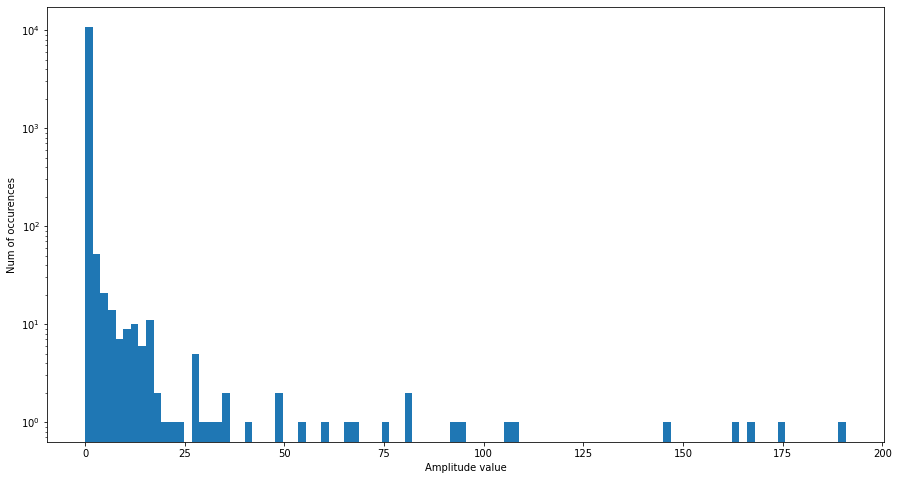

In [ ]:
# data_fft has the frequency bins in its first dim and the
# time windows in its second dim
amps = np.abs(data_fft[:, 0])
print("Amplitude values: ", amps)
ax = pd.Series(amps).plot.hist(logy=True, bins=100)
ax.set_xlabel("Amplitude value")
ax.set_ylabel("Num of occurences");

And we can also take a look at the phase of each bin for the first window.

Phase values:  [ 0.000000e+00  3.141465e+00 -1.305805e-04 ... -8.607925e-05 -3.141565e+00
  0.000000e+00]


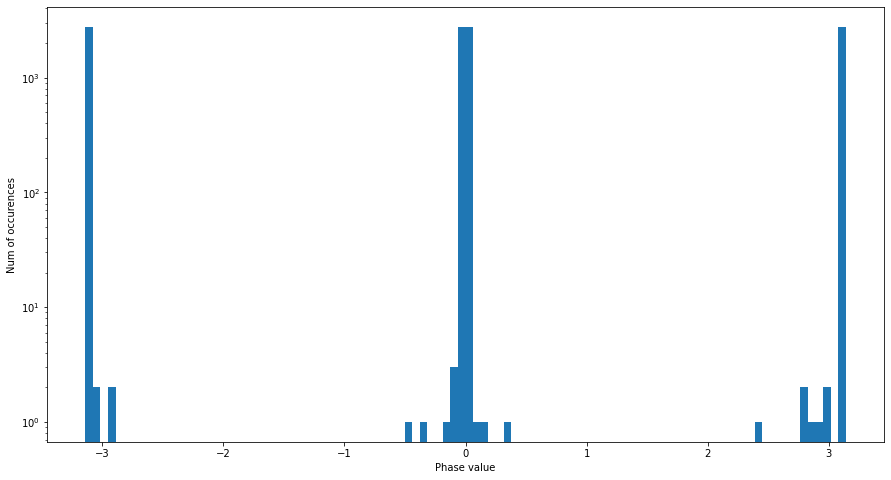

In [ ]:
# data_fft has the frequency bins in its first dim and the
# time windows in its second dim
phases = np.angle(data_fft[:, 0])
print("Phase values: ", phases)
ax = pd.Series(phases).plot.hist(logy=True, bins=100)
ax.set_xlabel("Phase value")
ax.set_ylabel("Num of occurences");

We note that the values of phase lie in $(-\pi, \pi]$ as this is the image domain of atan2.

Before we start modifying the values of the STFT we will convert the STFT values back to a PCM encoded signal which we can easily playback.

In [ ]:
display(Audio(
    data=librosa.istft(data_fft, hop_length=HOP_LENGTH, win_length=WIN_LENGTH),
    rate=sr,
))

We can hear that although we transformed it via STFT and the inverse STFT we still can reconstruct the original signal perfectly.

### Modifying the FFT matrix

As we have access to the FFT matrix we can also its values.
This allows us to modify the signal in a different way than just having access to the PCM values.

#### Modifying values

We start by removing the phase information by setting it to 0.
We can achive this by using the absolute value $|z| = \sqrt{x^2 + y^2}$, which defines the amplitude, as the real component and leave the imaginary component zero.

In [ ]:
display(Audio(
    data=librosa.istft(np.abs(data_fft), hop_length=HOP_LENGTH, win_length=WIN_LENGTH),
    rate=sr,
))

We can already hear that this introduces an amplitude modulation as all sine waves start at the same time.
Therefore the beginning of each window we have silence as $\sin(\text{freq}*\text{phase}) = 0$ if $\text{phase}=0$.
The `WIN_LENGTH` and `HOP_LENGTH` define the characteristics of the amplitude modulation in this case.

We can also take a look how the signal sounds if we *conjugate* our complex values.
Given a complex number $z:=x+iy$ the conjugate of $z$ is defined via $\overline{z}:=x-iy$.
We therefore change the phase of our values but do not modify its amplitude as $|z| = |\overline{z}|$.

![Complex absolute value](https://upload.wikimedia.org/wikipedia/commons/6/69/Complex_conjugate_picture.svg)

Source: https://commons.wikimedia.org/wiki/File:Complex_conjugate_picture.svg

In [ ]:
display(Audio(
    data=librosa.istft(np.conj(data_fft), hop_length=HOP_LENGTH, win_length=WIN_LENGTH),
    rate=sr,
))

This introduces an interesting shift of time for each frequency bin.
It behaves like a multiband delay whose delay times (negative and positive) get shuffled at each time window, although the shuffeling is not random but is dependent on its other parts.

#### Modifying order

We can use some array slicing in numpy to re-arange the order of our FFT matrix.
From {ref}`working-with-matrices` we know that Python and numpy use the notion of

```
start:stop:step_size
```

for the selection and re-arranging of arrays where, if not defined, the start is 0 and the stop is the end of the array and the step size is one.
Therefore `::-1` reverses the array.
We use `:` to keep the dimension untouced.

We start by inversing the second axis which is the time domain.

In [ ]:
display(Audio(
    data=librosa.istft(
        stft_matrix=data_fft[:, ::-1],
        hop_length=HOP_LENGTH,
        win_length=WIN_LENGTH
    ),
    rate=sr,
))

We can also reverse the order of the bins which is the first dimension of our FFT matrix.

In [ ]:
display(Audio(
    data=librosa.istft(
        stft_matrix=data_fft[::-1, :],
        hop_length=HOP_LENGTH,
        win_length=WIN_LENGTH
    ),
    rate=sr,
))

We can also scramble the fft bins for both dimensions.
For this we use `np.arange` to create a series of $n$ numbers and use `np.random.permutation` to permutate those numbers into a new ordering.
We then can use this reordered series of numbers as the indices of our FFT matrix which will reorder it.

We start by re-arranging along the bin axis.

In [ ]:
display(Audio(
    data=librosa.istft(
        stft_matrix=data_fft[np.random.permutation(np.arange(0, data_fft.shape[0])), :],
        hop_length=HOP_LENGTH,
        win_length=WIN_LENGTH
    ),
    rate=sr,
))

And now allong the time axis.

In [ ]:
display(Audio(
    data=librosa.istft(
        stft_matrix=data_fft[
            :,
            np.random.permutation(np.arange(0, data_fft.shape[1]))
        ],
        hop_length=HOP_LENGTH,
        win_length=WIN_LENGTH
    ),
    rate=sr,
))

We can also reset the phase to 0 via the $\text{abs}$ function (as seen above), mute all even frequency bins on even time windows and vice versa.

In [ ]:
copy_fft = np.copy(data_fft)

# reset phase
copy_fft = np.abs(copy_fft)

# mute even frequencies on even time
copy_fft[::2, ::2] = 0
# vice versa
copy_fft[1::2, 1::2] = 0

display(Audio(
    data=librosa.istft(
        stft_matrix=copy_fft,
        hop_length=HOP_LENGTH,
        win_length=WIN_LENGTH
    ),
    rate=sr,
))

## Spectogram

When working with sound files we often use a [spectogram](https://en.wikipedia.org/wiki/Spectrogram) to display the amplitude of a frequency at a specific time.
As this 3 dimensional vector is rather difficult to plot on a 2 dimensional screen we tend to transcend the dimension of amplitude into a color representation.
The main difference to FFT is that we are not interested in the phase of our signal as we have no need to re-construct the original signal from the visual representation but the spectogram relies on FFT as well.

Librosa has a built-in way to calculate the [mel spectogram](https://librosa.org/doc/main/generated/librosa.feature.melspectrogram.html).

In [ ]:
data_spec = librosa.feature.melspectrogram(data, sr=sr, hop_length=HOP_LENGTH, win_length=WIN_LENGTH, n_fft=N_FFT)
data_spec.shape

(128, 123)

In [ ]:
data_spec

array([[6.1129981e-01, 6.9615573e-02, 9.2120416e-02, ..., 3.2474060e-02,
        4.0274881e-02, 2.6646625e-02],
       [1.1160107e+00, 8.6185392e-03, 1.9175248e-02, ..., 9.1835700e-02,
        3.9624672e-02, 2.2018056e-02],
       [2.1654862e-01, 7.8314170e-03, 8.7827826e-03, ..., 1.6649935e-02,
        8.5100941e-03, 7.2227293e-03],
       ...,
       [3.0609652e-05, 3.5152865e-05, 5.4686083e-05, ..., 5.9910279e-05,
        6.2108615e-05, 4.9236445e-05],
       [4.1872801e-05, 4.2257307e-05, 4.6182246e-05, ..., 5.3868574e-05,
        5.9915208e-05, 4.2955351e-05],
       [4.8739221e-05, 3.9803021e-05, 4.5088007e-05, ..., 5.3943058e-05,
        5.6274108e-05, 5.2992524e-05]], dtype=float32)

In [ ]:
data_spec.shape

(128, 123)

Right now we are still using the notion of amplitude from our PCM signal but the more common way to talk about the volume of signals is *decibel* - thankfully librosa has already a built-in function to help us out on the conversion here and also a function which takes care of the scaling of our plot.

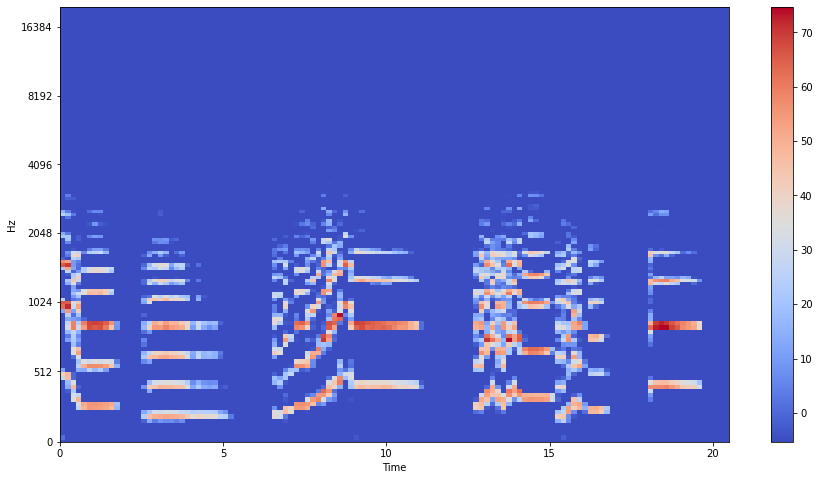

In [ ]:
librosa.display.specshow(
    librosa.amplitude_to_db(data_spec),
    x_axis='time',
    y_axis='mel',
    sr=sr,
    fmax=20000,
    hop_length=HOP_LENGTH,
)
plt.colorbar()
plt.show()

## Re-Arranging the spectogram

The basic idea was to re-order the windows of our spectogram.
Of course we could use any ordering but we want to focus here on an aproach which acounts the characteritics and patterns of our data which is one of the fundamental tasks of data science.

As an trivial ordering of elements is only possible in a single dimension we could use a dimensionality reduction algorithm to reduce the number of our frequency bins to 1.
By reducing it to 1 dimension we obtain a new ordering of our material which is based by the similarity by the content of each time window instead of the original temperal ordering.

We will use 2 algorithms: PCA and TSNE and compare how the differ.
Also we will train each algorithm on a reduction to 1 and to 2 dimensions - 1 dimension is necessary for our ordering but we can observe the characteristics of the algorithm better when using a 2 dimensional plot.

In [ ]:
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE

pca = PCA(n_components=1)
pca_2 = PCA(n_components=2)
tsne = TSNE(n_components=1, random_state=42)
tsne_2 = TSNE(n_components=2, random_state=42)

Instead of working on the raw spectogram data we transfer it to a decibel range which reflects our hearing and perception of amplitude in a better way.

We could also skip go back to amplitude range to compare the performance of the algorithms.

In [ ]:
data_spec_db = librosa.amplitude_to_db(data_spec)

### PCA

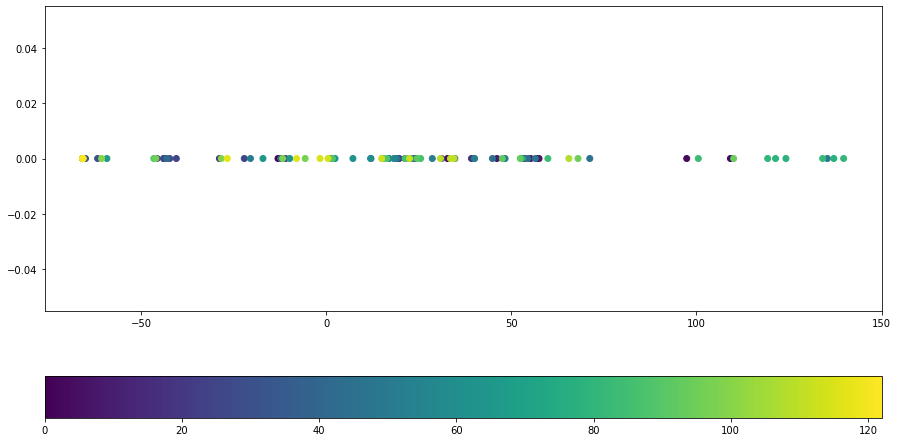

In [ ]:
data_pca = pca.fit_transform(data_spec_db.T)
plt.scatter(x=data_pca, y=np.zeros(data_pca.shape), c=np.arange(len(data_pca)))
#plt.scatter(x=data_pca, y=np.arange(len(data_pca)), c=np.arange(len(data_pca)))

plt.colorbar(location='bottom');

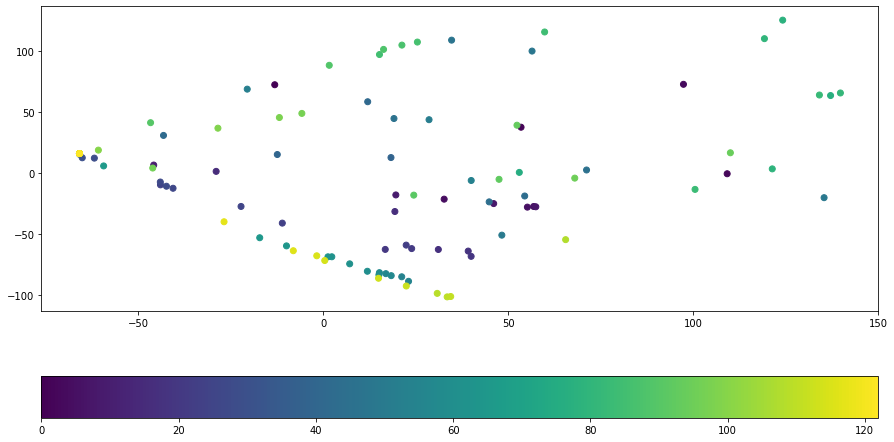

In [ ]:
data_pca_2 = pca_2.fit_transform(data_spec_db.T)
plt.scatter(x=data_pca_2[:, 0], y=data_pca_2[:, 1], c=np.arange((len(data_pca))))
plt.colorbar(location='bottom');

### T-sne

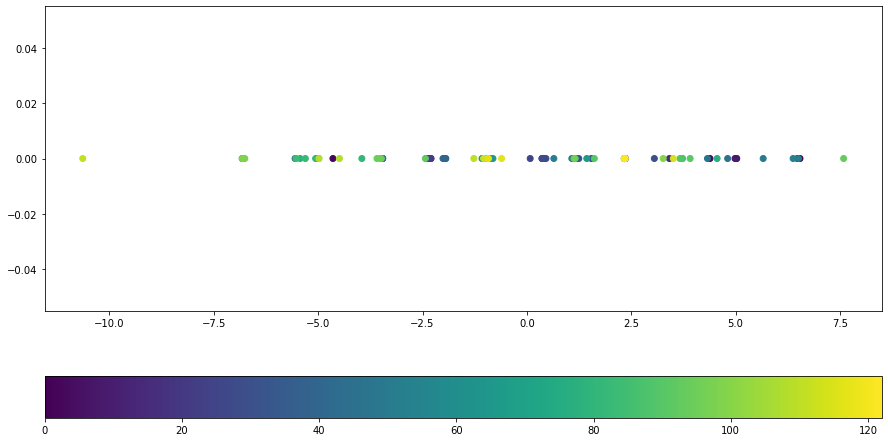

In [ ]:
data_tsne = tsne.fit_transform(data_spec_db.T)
plt.scatter(x=data_tsne, y=np.zeros(data_tsne.shape), c=np.arange(len(data_tsne)))
plt.colorbar(location='bottom');

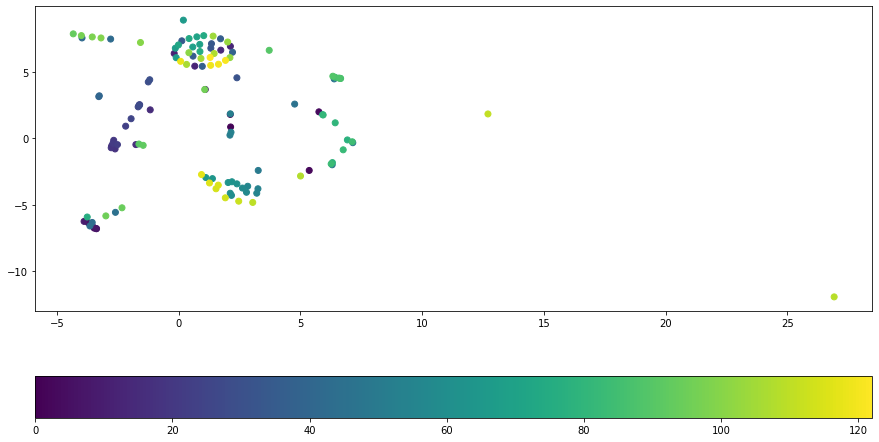

In [ ]:
data_tsne_2 = tsne_2.fit_transform(data_spec_db.T)
plt.scatter(x=data_tsne_2[:, 0], y=data_tsne_2[:, 1], c=np.arange(len(data_tsne)))
plt.colorbar(location='bottom');

When comparing the arragements of PCA and TSNE we see that the structure of TSNE is much mor distinct and has more structure which is reflected by our hearing.

There are some ways to make PCA also distinguish the structure by pre-processing (e.g. amp to decibel) the data and therefore shifting the focus on the aspects of data we want to distinguish.

### Reordering the spectorgram

We can use the 1-dimensional re-ordering of our spectogram as a new ordering of our spectogram.


In [ ]:
order = np.argsort(data_pca[:, 0])
order[[0, 1, 2, 3, 4, 5, 6]]

array([122, 120, 121,  32,  33,  34,  35])

In [ ]:
pca_order = np.argsort(data_pca[:, 0])
print(f"PCA reordering:\n{pca_order}")
fft_pca_order = data_fft[:, pca_order]
signal_pca = librosa.istft(fft_pca_order, hop_length=HOP_LENGTH, win_length=WIN_LENGTH)
display(Audio(signal_pca, rate=sr))

PCA reordering:
[122 120 121  32  33  34  35  36  37  38  73  72  71  70  69  68  67  75
  74  13  14 103  12 105 106 104 102 101 118 119 107  11  31  30  29 100
  66  90  96  10  27  24  42  28  26  15  99 117  25  52  65   0  40  98
  23  64 116  97 115 114  63  89  62  61  60  41 113  59  58  85  88  20
  56  39  57  46  16   9  54  87  22 112  55  21  91  86  51 109  17   4
 110 111  47  18  19  53  44   8  92  50  93  76   1  43   5  48   6   7
  84 108  95  45   3  83   2  94  80  79  78  82  49  77  81]


In [ ]:
tsne_order = np.argsort(data_tsne[:, 0])
print(f"tSNE reordering:\n{tsne_order}")
fft_tsne_order = data_fft[:, tsne_order]
signal_tsne = librosa.istft(fft_tsne_order, hop_length=HOP_LENGTH, win_length=WIN_LENGTH)
display(Audio(signal_tsne, rate=sr))

tSNE reordering:
[111  99  42  41  98  97  48  84  78  82  79  49  83  80 109   2 108  81
  94  76  95  43   6   5  44  92  19  16  18  22  20  21  17  39  23  40
 110  59  60 112 113  55  54  57  58  56  61  62  63 115 116  64  65 117
  25  26  28  24  27  51  47  86  96  85  10  29  66  31  90 107 104 102
  69  70 103 101 105 106 122  38  67  34  37  73  72  71  12  14  75  13
 121 120 119 118  33  11  74  32  68  36  35  30 100  15 114  89  88  87
  91  46   3  77  45   4   9   8   7  50  53   1  52   0  93]


## Re-writing into a class

After we have know the basic procedure of our algorithm we can wrap everything into a class to make it more reusable and also have a single command to run an experiment which allows us to speed up the search for more aesthetic pramaters.

In [ ]:
from typing import Optional, Callable

class SpectReorder:
    def __init__(
        self,
        file_path: str,
        hop_length: Optional[int] = None,
        win_length: Optional[int] = None,
        n_fft: Optional[int] = None,
        sr: Optional[int] = None,
        pre_process: Optional[Callable] = None,
        
    ):
        self.file_path = file_path
        self._data, self._sr = librosa.load(file_path, sr=sr, mono=True)
        
        self.hop_length = hop_length if hop_length else int(self._sr/2)
        self.win_length = win_length if win_length else int(self._sr)
        self.n_fft = n_fft if n_fft else self.win_length
        
        self._fft = librosa.stft(
            self._data,
            n_fft=self.n_fft,
            hop_length=self.hop_length,
            win_length=self.win_length,
        )
        
        self._spectogram = librosa.feature.melspectrogram(
            self._data,
            sr=self._sr,
            hop_length=self.hop_length,
            win_length=self.win_length,
            n_fft=self.n_fft
        )
        self.pre_process = pre_process if pre_process else lambda x: librosa.amplitude_to_db(x)
    
    def run_algorithm(self, dim_reduction = None):
        dim_reduction = dim_reduction if dim_reduction else TSNE(n_components=1)
        spect = self.pre_process(self._spectogram)
        spect_reduced = dim_reduction.fit_transform(spect.T)
        fft_re_order = self._fft[:, np.argsort(spect_reduced[:, 0])]
        reordered_signal = librosa.istft(
            fft_re_order,
            hop_length=self.hop_length,
            win_length=self.win_length,
        )
        return reordered_signal

In [ ]:
experiment = SpectReorder('violin.flac', hop_length=400, win_length=2000, sr=44100)
signal = experiment.run_algorithm()
display(Audio(signal, rate=experiment._sr))

Now we can tweak all parameters of our algorithm in a single line and compare multiple results because the config of the algorithm is now attached to the instance of our experiment and not shared globally by every experiment.

## Fine tuning the results

While listening to the results at least the PCA aproach relies too much on the amplitude of the signal and not on its 

In [ ]:
volume_scaling = lambda x: librosa.amplitude_to_db(x/np.sum(x, axis=1)[:, np.newaxis])

In [ ]:
experiment = SpectReorder(
    'trumpet.flac',
    hop_length=400,
    win_length=2000,
    sr=44100,
    pre_process=volume_scaling
)
signal = experiment.run_algorithm()
display(Audio(signal, rate=experiment._sr))

We can also apply a scaling on each frequency so that he higher frequencies are less important for our clustering than the low frequencies.
We can use an inversed log scale for this and multiply a matrix of these value to our spectogram.

In [ ]:
log_scaling = lambda x: np.matmul(np.repeat(np.log(np.arange(len(x)+1, 1, -1))[np.newaxis, :], len(x), axis=0), x)

In [ ]:
experiment = SpectReorder(
    'violin.flac',
    hop_length=400,
    win_length=2000,
    sr=44100,
    pre_process=log_scaling
)
signal = experiment.run_algorithm()
display(Audio(signal, rate=experiment._sr))

We can now combine these two pre-processing steps into one by nesting the functions.

In [ ]:
experiment = SpectReorder(
    'violin.flac',
    hop_length=400,
    win_length=2000,
    sr=44100,
    pre_process=lambda x: log_scaling(volume_scaling(x))
)
signal = experiment.run_algorithm()
display(Audio(signal, rate=experiment._sr))

## Where to go from here

Currently we are not considering the cluster of similar grains.
Instead of playing them in their ordinal order we could play them according to the distance of their reduced dimensionality.

We also restricted ourselves to a 1 dimensional reduction as the ordering then becomes trivial. But by moving to higher dimensions the replacing of samples could be composed via [n nearest neighbors](https://scikit-learn.org/stable/modules/neighbors.html).